In [2]:
import pandas as pd
import geopandas as gpd
import os
import folium as flm

In [3]:
def get_data(folder):
    """
    Loads the data via a function so we can cache the files.

    Args:
        folder (str): url to the folder containing the data.

    Returns:
        dict: Returns a dictionary of data frames. File name is the key. Data frame is the values.
    """
    data_folder = folder
    files = [f for f in os.listdir(data_folder) if f.endswith('.csv')]
    dfs = {}
    for file in files:
        df_name = os.path.splitext(file)[0]
        df = pd.read_csv(os.path.join(data_folder, file))
        dfs[df_name] = df.set_index(df.columns[0])
    return dfs

In [4]:
def get_map_data(url):
    """
    Loads the data via a function so we can cache the files.

    Args:
        url (str): url to the file containing the data.

    Returns:
        pd.Dataframe: Returns a dataframe of the data.
    """
    df1 = pd.read_csv(url)
    df1 = pd.DataFrame(df1)
    return df1

In [5]:
def get_data_noah(folder, name):
    """
    Reads all files inside a directory and creates a dataframe for each file.
    The dataframe names are created from the df parameter plus an incremental number n.

    Args:
        folder (str): Path to the directory containing the files.
        name (str): Base name for the dataframes.

    Returns:
        list: A list of dataframes.
    """
    # Get all files inside the directory
    files = [file for file in os.listdir(folder) if os.path.isfile(os.path.join(folder, file))]
    
    # Create a list to store the dataframes
    dataframes = []
    
    # Loop through each file and create a dataframe for it
    for i, file in enumerate(files):
        file_path = os.path.join(folder, file)
        df_name = f'{name}_{i}'
        df = gpd.read_parquet(file_path)
        dataframes.append(df)
    
    return dataframes

In [51]:
url = "../task-5-web-app-deployment/data/noah/old"
name = "storm_surge"

df_list = get_data_noah(url, name)

In [52]:
df_list

[              name  HAZ                                           geometry  \
 0          Aborlan  1.0  MULTIPOLYGON (((118.28959 9.54966, 118.28959 9...   
 3     Abra De Ilog  1.0  MULTIPOLYGON (((120.72038 13.47957, 120.72039 ...   
 6           Abucay  1.0  MULTIPOLYGON (((120.53277 14.71896, 120.53287 ...   
 9           Abulug  1.0  MULTIPOLYGON (((121.40857 18.44890, 121.40894 ...   
 12          Abuyog  1.0  MULTIPOLYGON (((125.00252 10.72305, 125.00268 ...   
 ...            ...  ...                                                ...   
 2586       Vinzons  1.0  MULTIPOLYGON (((122.89372 14.19802, 122.89372 ...   
 2589         Virac  1.0  MULTIPOLYGON (((124.18660 13.52278, 124.18660 ...   
 2592     Zamboanga  1.0  MULTIPOLYGON (((121.93568 6.96951, 121.93567 6...   
 2595  Zamboanguita  1.0  MULTIPOLYGON (((123.13023 9.04770, 123.13050 9...   
 2598       Zarraga  1.0  MULTIPOLYGON (((122.64638 10.77461, 122.64638 ...   
 
       index          City  
 0         0       Ab

In [53]:
df_list[0]

,name,HAZ,geometry,index,City
0,Aborlan,1.0,"MULTIPOLYGON (((118.28959 9.54966, 118.28959 9...",0,Aborlan
3,Abra De Ilog,1.0,"MULTIPOLYGON (((120.72038 13.47957, 120.72039 ...",0,Abra De Ilog
6,Abucay,1.0,"MULTIPOLYGON (((120.53277 14.71896, 120.53287 ...",0,Abucay
9,Abulug,1.0,"MULTIPOLYGON (((121.40857 18.44890, 121.40894 ...",0,Abulug
12,Abuyog,1.0,"MULTIPOLYGON (((125.00252 10.72305, 125.00268 ...",0,Abuyog
...,...,...,...,...,...
2586,Vinzons,1.0,"MULTIPOLYGON (((122.89372 14.19802, 122.89372 ...",8,Vinzons
2589,Virac,1.0,"MULTIPOLYGON (((124.18660 13.52278, 124.18660 ...",9,Virac
2592,Zamboanga,1.0,"MULTIPOLYGON (((121.93568 6.96951, 121.93567 6...",19,Zamboanga
2595,Zamboanguita,1.0,"MULTIPOLYGON (((123.13023 9.04770, 123.13050 9...",21,Zamboanguita


In [54]:
in1 = df_list[0]
in1.isnull().sum()

name        0
HAZ         0
geometry    0
index       0
City        0
dtype: int64

In [47]:
list1 = in1['province']
list1.to_csv('list1.csv')

In [43]:
in1[in1['province'] =='Abra']

,name,HAZ,geometry,index,City,province


In [45]:
in1[in1['City'] =='Aborlan']

,name,HAZ,geometry,index,City,province
0,Aborlan,1.0,"MULTIPOLYGON (((118.28959 9.54966, 118.28959 9...",0,Aborlan,Palawan


In [41]:
in1.head(132)

,name,HAZ,geometry,index,City,province


<AxesSubplot:>

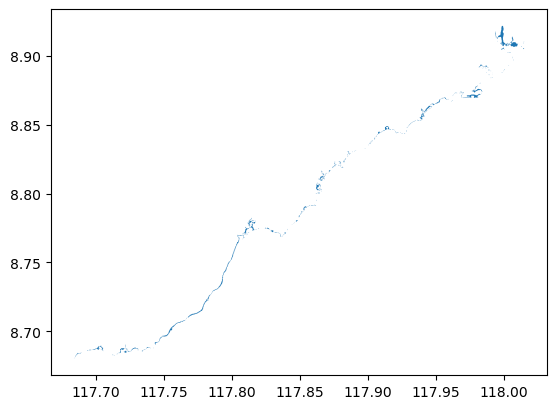

In [11]:
in1[in1['name'] == "Brooke's Point"].plot()

In [65]:
stat0 = gpd.read_file('../../data/geolocation/gadm41_PHL_shp/gadm41_PHL_0.shp')

In [66]:
stat0.head()

,GID_0,COUNTRY,geometry
0,PHL,Philippines,"MULTIPOLYGON (((125.38222 5.37056, 125.38194 5..."


In [61]:
stat1 = gpd.read_file('../../data/geolocation/gadm41_PHL_shp/gadm41_PHL_1.shp')

In [67]:
stat1.head()

,GID_1,GID_0,COUNTRY,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,ISO_1,geometry
0,PHL.1_1,PHL,Philippines,Abra,NA,NA,Lalawigan,Province,1401,PH.AB,PH-ABR,"POLYGON ((120.74773 17.15755, 120.73747 17.156..."
1,PHL.2_1,PHL,Philippines,Agusan del Norte,NA,NA,Lalawigan,Province,1602,PH.AN,PH-AGN,"POLYGON ((125.51141 8.70021, 125.49689 8.70089..."
2,PHL.3_1,PHL,Philippines,Agusan del Sur,NA,NA,Lalawigan,Province,1603,PH.AS,PH-AGS,"POLYGON ((126.05209 7.93625, 126.04572 7.93504..."
3,PHL.4_1,PHL,Philippines,Aklan,NA,NA,Lalawigan,Province,604,PH.AK,PH-AKL,"MULTIPOLYGON (((122.28702 11.74581, 122.28805 ..."
4,PHL.5_1,PHL,Philippines,Albay,NA,NA,Lalawigan,Province,505,PH.AL,PH-ALB,"MULTIPOLYGON (((123.44640 13.02776, 123.44541 ..."


In [63]:
stat2 = gpd.read_file('../../data/geolocation/gadm41_PHL_shp/gadm41_PHL_2.shp')

In [68]:
stat2.head()

,GID_2,GID_0,COUNTRY,GID_1,NAME_1,NL_NAME_1,NAME_2,VARNAME_2,NL_NAME_2,TYPE_2,ENGTYPE_2,CC_2,HASC_2,geometry
0,PHL.1.1_1,PHL,Philippines,PHL.1_1,Abra,NA,Bangued,NA,NA,Bayan|Munisipyo,Municipality,140101,PH.AB.BN,"POLYGON ((120.61134 17.49558, 120.60941 17.496..."
1,PHL.1.2_1,PHL,Philippines,PHL.1_1,Abra,NA,Boliney,NA,NA,Bayan|Munisipyo,Municipality,140102,PH.AB.BL,"POLYGON ((120.81400 17.34210, 120.76862 17.340..."
2,PHL.1.3_1,PHL,Philippines,PHL.1_1,Abra,NA,Bucay,NA,NA,Bayan|Munisipyo,Municipality,140103,PH.AB.BU,"POLYGON ((120.67766 17.45736, 120.67324 17.469..."
3,PHL.1.4_1,PHL,Philippines,PHL.1_1,Abra,NA,Bucloc,NA,NA,Bayan|Munisipyo,Municipality,140104,PH.AB.BC,"POLYGON ((120.78922 17.44525, 120.80331 17.449..."
4,PHL.1.5_1,PHL,Philippines,PHL.1_1,Abra,NA,Daguioman,NA,NA,Bayan|Munisipyo,Municipality,140105,PH.AB.DG,"POLYGON ((120.90749 17.41933, 120.89281 17.446..."


In [69]:
stat3 = gpd.read_file('../../data/geolocation/gadm41_PHL_shp/gadm41_PHL_3.shp')

In [71]:
stat3.head()

,GID_3,GID_0,COUNTRY,GID_1,NAME_1,NL_NAME_1,GID_2,NAME_2,NL_NAME_2,NAME_3,VARNAME_3,NL_NAME_3,TYPE_3,ENGTYPE_3,CC_3,HASC_3,geometry
0,PHL.1.1.1_1,PHL,Philippines,PHL.1_1,Abra,NA,PHL.1.1_1,Bangued,NA,Agtangao,NA,NA,Barangay,Village,NA,NA,"POLYGON ((120.62390 17.57298, 120.62534 17.573..."
1,PHL.1.1.2_1,PHL,Philippines,PHL.1_1,Abra,NA,PHL.1.1_1,Bangued,NA,Angad,NA,NA,Barangay,Village,NA,NA,"POLYGON ((120.63432 17.58044, 120.63396 17.579..."
2,PHL.1.1.3_1,PHL,Philippines,PHL.1_1,Abra,NA,PHL.1.1_1,Bangued,NA,Bañacao,NA,NA,Barangay,Village,NA,NA,"POLYGON ((120.59626 17.61632, 120.59573 17.605..."
3,PHL.1.1.4_1,PHL,Philippines,PHL.1_1,Abra,NA,PHL.1.1_1,Bangued,NA,Bangbangar,NA,NA,Barangay,Village,NA,NA,"POLYGON ((120.59573 17.60569, 120.59626 17.616..."
4,PHL.1.1.5_1,PHL,Philippines,PHL.1_1,Abra,NA,PHL.1.1_1,Bangued,NA,Cabuloan,NA,NA,Barangay,Village,NA,NA,"POLYGON ((120.58296 17.59962, 120.59573 17.605..."


In [70]:
stat0.isnull().sum(), stat1.isnull().sum(), stat2.isnull().sum(), stat3.isnull().sum()

(GID_0       0
 COUNTRY     0
 geometry    0
 dtype: int64,
 GID_1        0
 GID_0        0
 COUNTRY      0
 NAME_1       0
 VARNAME_1    0
 NL_NAME_1    0
 TYPE_1       0
 ENGTYPE_1    0
 CC_1         0
 HASC_1       0
 ISO_1        0
 geometry     0
 dtype: int64,
 GID_2        0
 GID_0        0
 COUNTRY      0
 GID_1        0
 NAME_1       0
 NL_NAME_1    0
 NAME_2       0
 VARNAME_2    0
 NL_NAME_2    0
 TYPE_2       0
 ENGTYPE_2    0
 CC_2         0
 HASC_2       0
 geometry     0
 dtype: int64,
 GID_3        0
 GID_0        0
 COUNTRY      0
 GID_1        0
 NAME_1       0
 NL_NAME_1    0
 GID_2        0
 NAME_2       0
 NL_NAME_2    0
 NAME_3       0
 VARNAME_3    0
 NL_NAME_3    0
 TYPE_3       0
 ENGTYPE_3    0
 CC_3         0
 HASC_3       0
 geometry     0
 dtype: int64)

In [72]:
stat0['geometry'].nunique(), stat1['geometry'].nunique(), stat2['geometry'].nunique(), stat3['geometry'].nunique()

(1, 81, 1647, 41948)

In [79]:
stat2_city = stat2['NAME_2']
stat2_city.to_csv('stat2_city.csv')

In [14]:
df_list[1]

,name,HAZ,geometry,index,City,province
1,Aborlan,2.0,"MULTIPOLYGON (((118.28959 9.54966, 118.28868 9...",22,Aborlan,Palawan
4,Abra De Ilog,2.0,"MULTIPOLYGON (((120.63924 13.48777, 120.63924 ...",14,Abra De Ilog,Occidental Mindoro
7,Abucay,2.0,"MULTIPOLYGON (((120.54415 14.70656, 120.54454 ...",12,Abucay,Bataan
10,Abulug,2.0,"MULTIPOLYGON (((121.42667 18.43640, 121.42667 ...",16,Abulug,Cagayan
13,Abuyog,2.0,"MULTIPOLYGON (((125.00177 10.70976, 125.00342 ...",31,Abuyog,Leyte
...,...,...,...,...,...,...
2587,Vinzons,2.0,"MULTIPOLYGON (((122.89317 14.19804, 122.89280 ...",17,Vinzons,Camarines Norte
2590,Virac,2.0,"MULTIPOLYGON (((124.17813 13.52860, 124.17794 ...",19,Virac,Catanduanes
2593,Zamboanga,2.0,"MULTIPOLYGON (((121.93451 6.97044, 121.93440 6...",39,Zamboanga,Zamboanga del Sur
2596,Zamboanguita,2.0,"MULTIPOLYGON (((123.13029 9.04750, 123.13024 9...",43,Zamboanguita,Negros Oriental


In [15]:
df_list[2]

,name,HAZ,geometry,index,City,province
2,Aborlan,3.0,"MULTIPOLYGON (((118.28977 9.54984, 118.28959 9...",44,Aborlan,Palawan
5,Abra De Ilog,3.0,"MULTIPOLYGON (((120.68485 13.48702, 120.68504 ...",28,Abra De Ilog,Occidental Mindoro
8,Abucay,3.0,"MULTIPOLYGON (((120.54150 14.71846, 120.54179 ...",24,Abucay,Bataan
11,Abulug,3.0,"MULTIPOLYGON (((121.43252 18.45832, 121.43177 ...",32,Abulug,Cagayan
14,Abuyog,3.0,"MULTIPOLYGON (((125.00195 10.73146, 125.00191 ...",65,Abuyog,Leyte
...,...,...,...,...,...,...
2588,Vinzons,3.0,"MULTIPOLYGON (((122.91521 14.19343, 122.91521 ...",27,Vinzons,Camarines Norte
2591,Virac,3.0,"MULTIPOLYGON (((124.19099 13.51972, 124.19120 ...",29,Virac,Catanduanes
2594,Zamboanga,3.0,"MULTIPOLYGON (((121.93858 6.96468, 121.93847 6...",58,Zamboanga,Zamboanga del Sur
2597,Zamboanguita,3.0,"MULTIPOLYGON (((123.13050 9.04777, 123.13050 9...",65,Zamboanguita,Negros Oriental


In [16]:
prov = 'Palawan'

In [17]:
pgg = df_list[2][df_list[2]['province'] == prov]
pgg

,name,HAZ,geometry,index,City,province
2,Aborlan,3.0,"MULTIPOLYGON (((118.28977 9.54984, 118.28959 9...",44,Aborlan,Palawan
26,Agutaya,3.0,"MULTIPOLYGON (((120.73777 11.34818, 120.73787 ...",45,Agutaya,Palawan
100,Araceli,3.0,"MULTIPOLYGON (((119.79095 10.54578, 119.79095 ...",46,Araceli,Palawan
185,Balabac,3.0,"MULTIPOLYGON (((116.95774 7.90648, 116.95775 7...",47,Balabac,Palawan
310,Bataraza,3.0,"MULTIPOLYGON (((117.19679 8.33170, 117.19679 8...",48,Bataraza,Palawan
462,Busuanga,3.0,"MULTIPOLYGON (((119.83185 11.98089, 119.83191 ...",50,Busuanga,Palawan
673,Coron,3.0,"MULTIPOLYGON (((120.03952 11.67108, 120.03949 ...",51,Coron,Palawan
691,Culion,3.0,"MULTIPOLYGON (((119.82236 11.93948, 119.82200 ...",52,Culion,Palawan
697,Cuyo,3.0,"MULTIPOLYGON (((120.69376 11.10343, 120.69376 ...",53,Cuyo,Palawan
811,Dumaran,3.0,"MULTIPOLYGON (((119.54957 10.36884, 119.54980 ...",54,Dumaran,Palawan


In [18]:
map_url = '../task-5-web-app-deployment/data/all_data.csv'
df1 = get_map_data(map_url)

In [19]:
df1

,city_municipality,total_population,pov_inc,hospitals,infirmary,barangay_health_station,rural_health_unit,birthing_home,covid-19_testing_laboratory,province,...,cluster_id_heal,vulnerability_heal,cost_of_living,poverty_incidents_povt,population,financial_deepening,employed_population,cluster_id_povt,vulnerability_povt,country
0,Aborlan,35091,13.33,1.0,0.0,18.0,1.0,0.0,0.0,Palawan,...,2,High,0.737637,0.141845,0.054114,0.112828,0.007804,1,Medium,Philippines
1,Abra De Ilog,31306,20.46,0.0,1.0,9.0,1.0,0.0,0.0,Occidental Mindoro,...,0,Medium,0.781364,0.232656,0.047528,0.040603,0.080855,1,Medium,Philippines
2,Abucay,42984,5.30,0.0,0.0,11.0,1.0,1.0,0.0,Bataan,...,0,Medium,0.548175,0.039571,0.067850,0.311169,0.371140,0,Low,Philippines
3,Abulug,32497,14.79,1.0,0.0,8.0,1.0,0.0,0.0,Cagayan,...,0,Medium,0.621007,0.160440,0.049600,0.641586,0.020086,0,Low,Philippines
4,Abuyog,59571,28.17,1.0,0.0,17.0,2.0,4.0,0.0,Leyte,...,0,Medium,0.350318,0.330855,0.096715,0.469916,0.012154,0,Low,Philippines
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1627,Zamboanga,977234,18.00,13.0,3.0,87.0,17.0,17.0,4.0,Zamboanga del Sur,...,1,Low,0.825091,0.201325,1.000000,0.309794,0.129982,1,Medium,Philippines
1628,Zamboanguita,27552,17.50,0.0,0.0,10.0,1.0,0.0,0.0,Negros Oriental,...,0,Medium,0.803262,0.194956,0.040995,0.105770,0.027890,1,Medium,Philippines
1629,Zaragoza,53090,3.82,0.0,0.0,6.0,2.0,2.0,0.0,Nueva Ecija,...,1,Low,0.999650,0.020721,0.085437,0.559921,0.029041,1,Medium,Philippines
1630,Zarraga,27305,10.83,0.0,0.0,4.0,1.0,0.0,0.0,Iloilo,...,0,Medium,0.985448,0.110004,0.040565,0.238945,0.102476,1,Medium,Philippines


In [22]:
df1.isnull().sum()

city_municipality                        0
total_population                         0
pov_inc                                  0
hospitals                                1
infirmary                                1
barangay_health_station                  1
rural_health_unit                        1
birthing_home                            1
covid-19_testing_laboratory              1
province                                 0
latitude                                 0
longitude                                0
geometry                                 8
presence_of_investment_promotion_unit    0
active_establishments_in_the_locality    0
productivity                             0
employment_generation                    0
poverty_incidents_dweg                   0
cluster_id_dweg                          0
vulnerability_dweg                       0
early_warning_system                     0
budget_for_drrmp                         0
land_use_plan                            0
annual_disa

In [20]:
geo1 = gpd.read_parquet('../task-5-web-app-deployment/data/noah/ss1.parquet')
geo2 = gpd.read_parquet('../task-5-web-app-deployment/data/noah/ss2.parquet')
geo3 = gpd.read_parquet('../task-5-web-app-deployment/data/noah/ss3.parquet')

In [21]:
geo1.isnull().sum()

name        0
HAZ         0
geometry    0
index       0
City        0
province    1
dtype: int64

In [ ]:
df1['warehouse'] = df1['store'].map(df2.set_index('store_code')['warehouse'])

In [28]:
geo1['province'] = geo1['City'].map(df1.set_index('city_municipality')['province'])
geo1

,name,HAZ,geometry,index,City,province
0,Aborlan,1.0,"MULTIPOLYGON (((118.28959 9.54966, 118.28959 9...",0,Aborlan,Palawan
3,Abra De Ilog,1.0,"MULTIPOLYGON (((120.72038 13.47957, 120.72039 ...",0,Abra De Ilog,Occidental Mindoro
6,Abucay,1.0,"MULTIPOLYGON (((120.53277 14.71896, 120.53287 ...",0,Abucay,Bataan
9,Abulug,1.0,"MULTIPOLYGON (((121.40857 18.44890, 121.40894 ...",0,Abulug,Cagayan
12,Abuyog,1.0,"MULTIPOLYGON (((125.00252 10.72305, 125.00268 ...",0,Abuyog,Leyte
...,...,...,...,...,...,...
2586,Vinzons,1.0,"MULTIPOLYGON (((122.89372 14.19802, 122.89372 ...",8,Vinzons,Camarines Norte
2589,Virac,1.0,"MULTIPOLYGON (((124.18660 13.52278, 124.18660 ...",9,Virac,Catanduanes
2592,Zamboanga,1.0,"MULTIPOLYGON (((121.93568 6.96951, 121.93567 6...",19,Zamboanga,Zamboanga del Sur
2595,Zamboanguita,1.0,"MULTIPOLYGON (((123.13023 9.04770, 123.13050 9...",21,Zamboanguita,Negros Oriental


In [29]:
geo2['province'] = geo2['City'].map(df1.set_index('city_municipality')['province'])
geo2

,name,HAZ,geometry,index,City,province
1,Aborlan,2.0,"MULTIPOLYGON (((118.28959 9.54966, 118.28868 9...",22,Aborlan,Palawan
4,Abra De Ilog,2.0,"MULTIPOLYGON (((120.63924 13.48777, 120.63924 ...",14,Abra De Ilog,Occidental Mindoro
7,Abucay,2.0,"MULTIPOLYGON (((120.54415 14.70656, 120.54454 ...",12,Abucay,Bataan
10,Abulug,2.0,"MULTIPOLYGON (((121.42667 18.43640, 121.42667 ...",16,Abulug,Cagayan
13,Abuyog,2.0,"MULTIPOLYGON (((125.00177 10.70976, 125.00342 ...",31,Abuyog,Leyte
...,...,...,...,...,...,...
2587,Vinzons,2.0,"MULTIPOLYGON (((122.89317 14.19804, 122.89280 ...",17,Vinzons,Camarines Norte
2590,Virac,2.0,"MULTIPOLYGON (((124.17813 13.52860, 124.17794 ...",19,Virac,Catanduanes
2593,Zamboanga,2.0,"MULTIPOLYGON (((121.93451 6.97044, 121.93440 6...",39,Zamboanga,Zamboanga del Sur
2596,Zamboanguita,2.0,"MULTIPOLYGON (((123.13029 9.04750, 123.13024 9...",43,Zamboanguita,Negros Oriental


In [30]:
geo3['province'] = geo3['City'].map(df1.set_index('city_municipality')['province'])
geo3

,name,HAZ,geometry,index,City,province
2,Aborlan,3.0,"MULTIPOLYGON (((118.28977 9.54984, 118.28959 9...",44,Aborlan,Palawan
5,Abra De Ilog,3.0,"MULTIPOLYGON (((120.68485 13.48702, 120.68504 ...",28,Abra De Ilog,Occidental Mindoro
8,Abucay,3.0,"MULTIPOLYGON (((120.54150 14.71846, 120.54179 ...",24,Abucay,Bataan
11,Abulug,3.0,"MULTIPOLYGON (((121.43252 18.45832, 121.43177 ...",32,Abulug,Cagayan
14,Abuyog,3.0,"MULTIPOLYGON (((125.00195 10.73146, 125.00191 ...",65,Abuyog,Leyte
...,...,...,...,...,...,...
2588,Vinzons,3.0,"MULTIPOLYGON (((122.91521 14.19343, 122.91521 ...",27,Vinzons,Camarines Norte
2591,Virac,3.0,"MULTIPOLYGON (((124.19099 13.51972, 124.19120 ...",29,Virac,Catanduanes
2594,Zamboanga,3.0,"MULTIPOLYGON (((121.93858 6.96468, 121.93847 6...",58,Zamboanga,Zamboanga del Sur
2597,Zamboanguita,3.0,"MULTIPOLYGON (((123.13050 9.04777, 123.13050 9...",65,Zamboanguita,Negros Oriental


In [37]:
geo3.isnull().sum()

name        0
HAZ         0
geometry    0
index       0
City        0
province    0
dtype: int64

In [32]:
geo1 = geo1.dropna(how='any',axis=0)

In [34]:
geo2 = geo2.dropna(how='any',axis=0)

In [35]:
geo3 = geo3.dropna(how='any',axis=0)

In [38]:
geo1.to_parquet('../task-5-web-app-deployment/data/noah/ss1.parquet')
geo2.to_parquet('../task-5-web-app-deployment/data/noah/ss2.parquet')
geo3.to_parquet('../task-5-web-app-deployment/data/noah/ss3.parquet')

In [26]:
# Add map.
def map_ph(data, name, prov):
    cond = (
        data['country'] == name
            ) & (
            data['province'] == prov
                )

    lat = data[cond]['latitude'].tolist()
    lon = data[cond]['longitude'].tolist()
    nam = data[cond]['city_municipality'].tolist()
    vul_0 = data[cond]['vulnerability_dist'].tolist()
    vul_1 = data[cond]['vulnerability_dweg'].tolist()
    vul_2 = data[cond]['vulnerability_indu'].tolist()
    vul_3 = data[cond]['vulnerability_heal'].tolist()
    vul_4 = data[cond]['vulnerability_povt'].tolist()
    pop = data[cond]['total_population'].tolist()
    pov = data[cond]['pov_inc'].tolist()
    hop = data[cond]['hospital'].tolist()

    html = f''' <div style="font-family: monospace;font-size: 1rem;">
    <h4 style="font-size:1.05rem;">Vulnerability Info</h4>
    <ul style="list-style-type: none;margin: 0;padding: 0;">
    <li>City/Town: </li>
    <li> <b> %s</b></li>
    <li><b>Vulnerability Levels:</b></li>
    <li>Disaster: <b> %s</b></li>
    <li>Economy: <b> %s</b></li>
    <li>Industry: <b> %s</b></li>
    <li>Health: <b> %s</b></li>
    <li>Poverty: <b> %s</b></li>
    <li>Population: <b> %s</b></li>
    <li>Poverty: <b> %s</b></li>
    <li>Hospitals: <b> %s</b></li>
    </ul>  
    </div>
    '''

    if lat and lon:
        map = flm.Map(location=[lat[0], lon[0]], zoom_start=10, scrollWheelZoom=False)
    else:
        return None

    fg = flm.FeatureGroup(name='Philippines Map')

    marker_props = {'Low': {'color': 'green', 'size': 10},
                'Medium': {'color': 'blue', 'size': 10},
                'High': {'color': 'red', 'size': 15}}

    for lt, ln, nm, v0, v1, v2, v3, v4, po, pv, ho in zip((lat), (lon), (nam), (vul_0), (vul_1), (vul_2), (vul_3), (vul_4), (pop), (pov), (hop)):
        iframe = flm.IFrame(html = html % ((nm), (v0), (v1), (v2), (v3), (v4), (po), (pv), int((ho))), height = 290)
        popup = flm.Popup(iframe, min_width=200, max_width=650)
        props = marker_props[v0]
        marker = flm.CircleMarker(location = [lt, ln], popup = popup, fill_color=props['color'], color='None', radius=props['size'], fill_opacity = 0.5)
        fg.add_child(marker)
        map.add_child(fg)

    fg1 = flm.FeatureGroup(name='Storm Surge 3')

    for _, r in df_list[0][df_list[0]['province'] == prov].iterrows():
        # Without simplifying the representation of each borough,
        # the map might not be displayed
        sim_geo = gpd.GeoSeries(r['geometry']).simplify(1000)
        geo_j = sim_geo.to_json()
        geo_j = flm.GeoJson(data=geo_j,
                            style_function=lambda x: {'fillColor': 'red', 'fillOpacity': 0.8})
        fg1.add_child(geo_j)
        map.add_child(fg1)

    fg2 = flm.FeatureGroup(name='Storm Surge 2')

    for _, r in df_list[1][df_list[1]['province'] == prov].iterrows():
        # Without simplifying the representation of each borough,
        # the map might not be displayed
        sim_geo = gpd.GeoSeries(r['geometry']).simplify(1000)
        geo_j = sim_geo.to_json()
        geo_j = flm.GeoJson(data=geo_j,
                            style_function=lambda x: {'fillColor': 'blue', 'fillOpacity': 0.8})
        fg2.add_child(geo_j)
        map.add_child(fg2)

    fg3 = flm.FeatureGroup(name='Storm Surge 1')

    for _, r in df_list[2][df_list[2]['province'] == prov].iterrows():
        # Without simplifying the representation of each borough,
        # the map might not be displayed
        sim_geo = gpd.GeoSeries(r['geometry']).simplify(1000)
        geo_j = sim_geo.to_json()
        geo_j = flm.GeoJson(data=geo_j,
                            style_function=lambda x: {'fillColor': 'green', 'fillOpacity': 0.8})
        fg3.add_child(geo_j)
        map.add_child(fg3)

    flm.LayerControl(collapsed=False).add_to(map)
    print(prov)
    # map.save('map1.html')
    return map

In [27]:
map_ph(df1, 'Philippines', 'Palawan')

Palawan
